In [145]:
import pandas as pd
from urllib.request import urlopen  
import os.path as osp
import os
import logging
import zipfile
from glob import glob
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

logging.getLogger().setLevel('INFO')

## Helpers

In [2]:
def download_file(url_str, path):
    url = urlopen(url_str)
    output = open(path, 'wb')       
    output.write(url.read())
    output.close()  
    
def extract_file(archive_path, target_dir):
    zip_file = zipfile.ZipFile(archive_path, 'r')
    zip_file.extractall(target_dir)
    zip_file.close()

## Download the dataset

In [82]:
BASE_URL = 'http://tennis-data.co.uk'
DATA_DIR = "tennis_data"
ATP_DIR = './{}/ATP'.format(DATA_DIR)
WTA_DIR = './{}/WTA'.format(DATA_DIR)

ATP_URLS = [BASE_URL + "/%i/%i.zip" % (i,i) for i in range(2000,2019)]
WTA_URLS = [BASE_URL + "/%iw/%i.zip" % (i,i) for i in range(2007,2019)]

os.makedirs(osp.join(ATP_DIR, 'archives'), exist_ok=True)
os.makedirs(osp.join(WTA_DIR, 'archives'), exist_ok=True)

for files, directory in ((ATP_URLS, ATP_DIR), (WTA_URLS, WTA_DIR)):
    for dl_path in files:
        logging.info("downloading & extracting file %s", dl_path)
        archive_path = osp.join(directory, 'archives', osp.basename(dl_path))
        download_file(dl_path, archive_path)
        extract_file(archive_path, directory)
    
ATP_FILES = sorted(glob("%s/*.xls*" % ATP_DIR))
WTA_FILES = sorted(glob("%s/*.xls*" % WTA_DIR))

df_atp = pd.concat([pd.read_excel(f) for f in ATP_FILES], ignore_index=True)
df_wta = pd.concat([pd.read_excel(f) for f in WTA_FILES], ignore_index=True)

logging.info("%i matches ATP in df_atp", df_atp.shape[0])
logging.info("%i matches WTA in df_wta", df_wta.shape[0])

INFO:root:downloading & extracting file http://tennis-data.co.uk/2000/2000.zip
INFO:root:downloading & extracting file http://tennis-data.co.uk/2001/2001.zip
INFO:root:downloading & extracting file http://tennis-data.co.uk/2002/2002.zip
INFO:root:downloading & extracting file http://tennis-data.co.uk/2003/2003.zip
INFO:root:downloading & extracting file http://tennis-data.co.uk/2004/2004.zip
INFO:root:downloading & extracting file http://tennis-data.co.uk/2005/2005.zip
INFO:root:downloading & extracting file http://tennis-data.co.uk/2006/2006.zip
INFO:root:downloading & extracting file http://tennis-data.co.uk/2007/2007.zip
INFO:root:downloading & extracting file http://tennis-data.co.uk/2008/2008.zip
INFO:root:downloading & extracting file http://tennis-data.co.uk/2009/2009.zip
INFO:root:downloading & extracting file http://tennis-data.co.uk/2010/2010.zip
INFO:root:downloading & extracting file http://tennis-data.co.uk/2011/2011.zip
INFO:root:downloading & extracting file http://tenni

## Your work

### Viewing and analysing the data

In [83]:
df_atp.head(5)

,ATP,Location,Tournament,Date,Series,Court,Surface,Round,Best of,Winner,...,UBW,UBL,LBW,LBL,SJW,SJL,MaxW,MaxL,AvgW,AvgL
0,1,Adelaide,Australian Hardcourt Championships,2000-01-03,International,Outdoor,Hard,1st Round,3,Dosedel S.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,Adelaide,Australian Hardcourt Championships,2000-01-03,International,Outdoor,Hard,1st Round,3,Enqvist T.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,Adelaide,Australian Hardcourt Championships,2000-01-03,International,Outdoor,Hard,1st Round,3,Escude N.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,Adelaide,Australian Hardcourt Championships,2000-01-03,International,Outdoor,Hard,1st Round,3,Federer R.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,Adelaide,Australian Hardcourt Championships,2000-01-03,International,Outdoor,Hard,1st Round,3,Fromberg R.,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [84]:
df_atp.shape

(52298, 54)

In [85]:
# df_atp.describe()
df_atp.columns

Index(['ATP', 'Location', 'Tournament', 'Date', 'Series', 'Court', 'Surface',
       'Round', 'Best of', 'Winner', 'Loser', 'WRank', 'LRank', 'W1', 'L1',
       'W2', 'L2', 'W3', 'L3', 'W4', 'L4', 'W5', 'L5', 'Wsets', 'Lsets',
       'Comment', 'CBW', 'CBL', 'GBW', 'GBL', 'IWW', 'IWL', 'SBW', 'SBL',
       'B365W', 'B365L', 'B&WW', 'B&WL', 'EXW', 'EXL', 'PSW', 'PSL', 'WPts',
       'LPts', 'UBW', 'UBL', 'LBW', 'LBL', 'SJW', 'SJL', 'MaxW', 'MaxL',
       'AvgW', 'AvgL'],
      dtype='object')

In [319]:
min_date = df_atp['Date'].min()
max_date = df_atp['Date'].max()

print("Minimum date:", min_date)
print("Maximum date:", max_date)

Minimum date: 2000-01-03 00:00:00
Maximum date: 2018-11-18 00:00:00


In [86]:
df_atp.dtypes

ATP                    int64
Location              object
Tournament            object
Date          datetime64[ns]
Series                object
Court                 object
Surface               object
Round                 object
Best of                int64
Winner                object
Loser                 object
WRank                 object
LRank                 object
W1                   float64
L1                   float64
W2                    object
L2                    object
W3                    object
L3                    object
W4                   float64
L4                   float64
W5                   float64
L5                   float64
Wsets                float64
Lsets                 object
Comment               object
CBW                  float64
CBL                  float64
GBW                  float64
GBL                  float64
IWW                  float64
IWL                  float64
SBW                  float64
SBL                  float64
B365W         

In [87]:
# Changing LSets column to float type
df_atp['Lsets'] = df_atp['Lsets'].astype(str).replace("`1","1").astype(float)
df_atp['Lsets'].dtype

dtype('float64')

## 1 Who are the three ATP players with the most wins?

In [1006]:
win_count = df_atp.groupby(["Winner"])["Winner"].count().sort_values(ascending=False)
win_count[0:3]

Winner
Federer R.     1121
Nadal R.        891
Djokovic N.     802
Name: Winner, dtype: int64

Let's visualize this ranking through a plot.

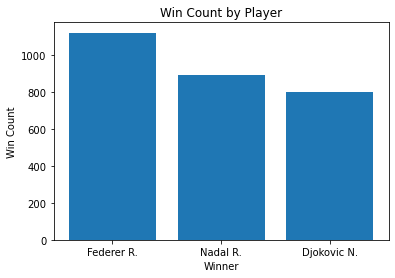

In [1019]:
import matplotlib.pyplot as plt

winner = ['Federer R.', 'Nadal R.', 'Djokovic N.']

plt.bar(winner, win_count[0:3])
plt.xlabel('Winner')
plt.ylabel('Win Count')
plt.title('Win Count by Player')
plt.show()

## 2. How many sets did the player “Federer R.” win in total? 

We will count the number of sets won by Federer in the matches he won and in the matches where he lost.

In [89]:
# Sets won by the player “Federer R.” in a winning match
m_w = df_atp.loc[df_atp["Winner"]=="Federer R.",["Wsets"]].sum()

# Sets won by the player “Federer R.” in a losing match
m_l = df_atp.loc[df_atp["Loser"]=="Federer R.",["Lsets"]].sum()

# Total sets won by the player “Federer R.”
total_sets_w = m_w[0]+m_l[0]

print("Sets won by the player “Federer R.” in a winning match : " + str(m_w[0]))
print("Sets won by the player “Federer R.” in a losing match : " + str(m_l[0]) +"\n")

print("Federer R. won in total : " + str(total_sets_w) + " sets.")

Sets won by the player “Federer R.” in a winning match : 2546.0
Sets won by the player “Federer R.” in a losing match : 150.0

Federer R. won in total : 2696.0 sets.


## 3. How many sets did the player “Federer R.” win during the years 2016 and 2017? 

First, we will filter the data on the year 2016 and 2017, then we will use the same aproach as earlier to count the sets won by the player “Federer R.” during the years 2016 and 2017.

In [90]:
# Keeping examples between 2016 and 2017 
filtered_df_atp = df_atp[df_atp["Date"].between("2016-01-01","2017-12-31")]

# Sum of sets won by Federer in a winning match
filtered_m_w = filtered_df_atp.loc[filtered_df_atp["Winner"]=="Federer R.",["Wsets"]].sum()

# Sum of sets won by Federer in a losing match
filtered_m_l = filtered_df_atp.loc[filtered_df_atp["Loser"]=="Federer R.",["Lsets"]].sum()

# Total sets won by Federer
filtered_total_sets_w = filtered_m_w[0] + filtered_m_l[0]

print("Sets won by the player “Federer R.” in a winning match during the years 2016 and 2017 : " + str(filtered_m_w[0]))
print("Sets won by the player “Federer R.” in a losing match during the years 2016 and 2017 : " + str(filtered_m_l[0]) +"\n")

print("Federer R. won in total during the years 2016 and 2017 : " + str(filtered_total_sets_w) + " sets.")

Sets won by the player “Federer R.” in a winning match during the years 2016 and 2017 : 172.0
Sets won by the player “Federer R.” in a losing match during the years 2016 and 2017 : 10.0

Federer R. won in total during the years 2016 and 2017 : 182.0 sets.


## 4. For each match, what is the percentage of victories of the winner in the past? 

To calculate the percentage of victories of the winner in the past, we need to count the number of matches the winner has won in the past and divide that by the total number of matches the winner has played in the past. We can calculate this for each match by using the "Winner" column and filtering the dataframe to only include matches that involve the winner.

In [92]:
# initialize an empty list to store the results
win_pct_list = []

# loop through each row in the dataframe
for i, row in df_atp.iterrows():
    # get the winner and filter the dataframe to only include past matches involving the winner
    winner = row['Winner']
    match_date = row['Date']
    winner_matches = df_atp[
        ((df_atp['Winner'] == winner) |
        (df_atp['Loser'] == winner)) & 
        (df_atp['Date'] < match_date)
    ]
    
    # count the number of matches the winner has won in the past
    past_wins = len(winner_matches[
        (winner_matches['Winner'] == winner) & 
        (df_atp['Date'] < match_date)
    ])
    
    # calculate the percentage of victories of the winner in the past
    total_matches = len(winner_matches)
    if total_matches > 0:
        win_pct = past_wins / total_matches
    else:
        win_pct = np.nan
    
    # add the result to the list
    win_pct_list.append(win_pct)

# add the list as a new column to the dataframe
df_atp['WinPct'] = win_pct_list

/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/1356902724.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  past_wins = len(winner_matches[
/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/1356902724.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  past_wins = len(winner_matches[
/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/1356902724.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  past_wins = len(winner_matches[
/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/1356902724.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  past_wins = len(winner_matches[
/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/1356902724.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  past_wins = len(winner_matches[
/var/folders/gl/65b8zpcs3_50ssdz8qs

In [97]:
df1 = df_atp[["Winner","Loser",'WinPct','Date']]
df1.tail()

,Winner,Loser,WinPct,Date
52293,Zverev A.,Isner J.,0.664032,2018-11-16
52294,Djokovic N.,Cilic M.,0.829876,2018-11-16
52295,Zverev A.,Federer R.,0.665354,2018-11-17
52296,Djokovic N.,Anderson K.,0.830052,2018-11-17
52297,Zverev A.,Djokovic N.,0.666667,2018-11-18


In [94]:
df1[
    (df1["Winner"]=="Federer R.")
    & df1.Date.between("2017-01-01","2017-12-31")
   ]

,Winner,Loser,WinPct,Date
47198,Federer R.,Melzer J.,0.824576,2017-01-16
47239,Federer R.,Rubin N.,0.824717,2017-01-18
47270,Federer R.,Berdych T.,0.824859,2017-01-20
47282,Federer R.,Nishikori K.,0.825000,2017-01-22
47288,Federer R.,Zverev M.,0.825141,2017-01-24
47291,Federer R.,Wawrinka S.,0.825282,2017-01-26
47293,Federer R.,Nadal R.,0.825422,2017-01-29
47584,Federer R.,Paire B.,0.825563,2017-02-27
47699,Federer R.,Robert S.,0.825040,2017-03-13
47715,Federer R.,Johnson S.,0.825180,2017-03-15


## Preprocessing

### Adding the win percentage of the loser in the past

Using the same approach as before, we will add for each match the percentage of victories of the loser in the past.

In [124]:
# initialize an empty list to store the results
loser_pct_list = []

# loop through each row in the dataframe
for i, row in df_atp.iterrows():
    # get the winner and filter the dataframe to only include past matches involving the winner
    loser = row['Loser']
    match_date = row['Date']
    loser_matches = df_atp[
        ((df_atp['Winner'] == loser) |
        (df_atp['Loser'] == loser)) & 
        (df_atp['Date'] < match_date)
    ]
    
    # count the number of matches the winner has won in the past
    past_wins = len(loser_matches[
        (loser_matches['Winner'] == loser) & 
        (df_atp['Date'] < match_date)
    ])
    
    # calculate the percentage of victories of the winner in the past
    total_matches = len(loser_matches)
    if total_matches > 0:
        win_pct = past_wins / total_matches
    else:
        win_pct = np.nan
    
    # add the result to the list
    loser_pct_list.append(win_pct)

# add the list as a new column to the dataframe
df_atp['WinPct_loser'] = loser_pct_list

/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/1540199213.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  past_wins = len(loser_matches[
/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/1540199213.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  past_wins = len(loser_matches[
/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/1540199213.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  past_wins = len(loser_matches[
/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/1540199213.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  past_wins = len(loser_matches[
/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/1540199213.py:16: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  past_wins = len(loser_matches[
/var/folders/gl/65b8zpcs3_50ssdz8qstbr24

### Handling missing values

In [807]:
df_atp.isnull().sum()

ATP                 0
Location            0
Tournament          0
Date                0
Series              0
Court               0
Surface             0
Round               0
Best of             0
Winner              0
Loser               0
WRank              15
LRank              78
W1                263
L1                261
W2                772
L2                771
W3              28129
L3              28130
W4              47567
L4              47567
W5              50507
L5              50507
Wsets             224
Lsets             225
Comment             0
CBW             34792
CBL             34792
GBW             47243
GBL             47243
IWW             38940
IWL             38940
SBW             46874
SBL             46874
B365W            8655
B365L            8632
B&WW            51201
B&WL            51201
EXW             12887
EXL             12882
PSW             14959
PSL             14959
WPts            16204
LPts            16263
UBW             41627
UBL       

#### Dropping columns

To handle missing values, we will first delete columns that have a lot of missing values.
Betting odds columns, WPts and LPts contain a lot of missing values, thus we will remove them.

We will also delete other columns such as Comment since it won't be relevent in the prediction, and ATP since we don't want it as input in our model later.

Moreover, we will delete columns containing the result points of the match, such as the number of games won in each set and the number of sets won in the match since this result is really hard to predict. We will only try to predict the match winner.

In [808]:
new_df_atp = df_atp.drop([ 'ATP','W1', 'L1','W2', 
                          'L2', 'W3', 'L3', 'W4', 'L4', 'W5', 'L5', 'Wsets', 
                          'Lsets','Comment', 'CBW', 'CBL', 'GBW', 'GBL', 'IWW', 
                          'IWL', 'SBW', 'SBL','B365W', 'B365L', 'B&WW', 'B&WL', 
                          'EXW', 'EXL', 'PSW', 'PSL', 'WPts','LPts', 'UBW', 
                          'UBL', 'LBW', 'LBL', 'SJW', 'SJL', 'MaxW', 'MaxL',
                          'AvgW', 'AvgL'],
                         axis=1)

In [809]:
new_df_atp.isnull().sum()

Location           0
Tournament         0
Date               0
Series             0
Court              0
Surface            0
Round              0
Best of            0
Winner             0
Loser              0
WRank             15
LRank             78
WinPct           552
WinPct_loser    1235
dtype: int64

#### Filling some missing values

In [810]:
print(new_df_atp["WRank"].dtype)
print(new_df_atp["LRank"].dtype)

object
object


To eliminate null values in the columns WRank and LRank, we will refer to null values as NR.

In [811]:
new_df_atp[["WRank","LRank"]] = new_df_atp[["WRank","LRank"]].fillna("NR")

In [812]:
new_df_atp.isnull().sum()

Location           0
Tournament         0
Date               0
Series             0
Court              0
Surface            0
Round              0
Best of            0
Winner             0
Loser              0
WRank              0
LRank              0
WinPct           552
WinPct_loser    1235
dtype: int64

#### Deleting rows

To deal with the remaining missing values, we will delete the rows containing the missing values.

In [813]:
new_df_atp.dropna(inplace=True)

In [814]:
new_df_atp.isnull().sum()

Location        0
Tournament      0
Date            0
Series          0
Court           0
Surface         0
Round           0
Best of         0
Winner          0
Loser           0
WRank           0
LRank           0
WinPct          0
WinPct_loser    0
dtype: int64

## Adding columns

Besides WinPct and WinPct_loser, we need to add other columns to be able the predict the result of a new match that did not happen yet.

First, we will add two columns containing the shuffled names of the two players disputing the match. These columns will replace the columns Winner and Loser so that we can later predict the winner on a new tennis match example. 

Second, we will add the respective ranks and previous win percentages of the players in four new columns.

Finally, we will add a column to determine the winner of the match between player 1 and player 2. This column will be the output that we want to predict later with our models.

In [815]:
import numpy as np

# Create a function to shuffle the names of players
def shuffle_players(x):
    # Use numpy.random.choice() to randomly select the player names
    player0, player1 = np.random.choice(
        [x['Winner'], x['Loser']], 
        size=2, 
        replace=False
    )
    return pd.Series([player0, player1])

# Apply the function to each row of the dataframe
new_df_atp[['Player 0', 'Player 1']] = new_df_atp.apply(shuffle_players, axis=1)

# Store the respective ranks and previous win percentages in four new columns
new_df_atp["Player 0 Rank"] = new_df_atp.apply(
    lambda x: x["WRank"] if x["Player 0"] == x["Winner"] else x["LRank"],
    axis=1
)
new_df_atp["Player 1 Rank"] = new_df_atp.apply(
    lambda x: x["WRank"] if x["Player 1"] == x["Winner"] else x["LRank"], 
    axis=1
)

new_df_atp["Player 0 WinPct"] = new_df_atp.apply(
    lambda x: x["WinPct"] if x["Player 0"] == x["Winner"] else x["WinPct_loser"], 
    axis=1
)
new_df_atp["Player 1 WinPct"] = new_df_atp.apply(
    lambda x: x["WinPct"] if x["Player 1"] == x["Winner"] else x["WinPct_loser"], 
    axis=1
)


In [816]:
# Create a function to determine the winner of the match.
def win_match(x):
    if x['Winner'] == x['Player 0']:
        return 0
    else:
        return 1

# Apply function on each row of the df
new_df_atp['Win Match'] = new_df_atp.apply(win_match, axis=1)

In [817]:
# Remove the redundant columns
new_df_atp.drop(
    columns=["Winner", "Loser", "WRank", "LRank","WinPct","WinPct_loser"], 
    inplace=True
)
new_df_atp.head()

,Location,Tournament,Date,Series,Court,Surface,Round,Best of,Player 0,Player 1,Player 0 Rank,Player 1 Rank,Player 0 WinPct,Player 1 WinPct,Win Match
93,Auckland,Heineken Open,2000-01-10,International,Outdoor,Hard,1st Round,3,Balcells J.,Squillari F.,211,49,0.000000,0.500000,0
94,Auckland,Heineken Open,2000-01-10,International,Outdoor,Hard,1st Round,3,Hantschk M.,Behrend T.,95,115,0.800000,0.500000,1
97,Auckland,Heineken Open,2000-01-10,International,Outdoor,Hard,1st Round,3,Gambill J.M.,Fromberg R.,57,80,0.500000,0.500000,0
102,Auckland,Heineken Open,2000-01-10,International,Outdoor,Hard,1st Round,3,Berasategui A.,Martin A.,59,48,0.500000,0.666667,1
106,Auckland,Heineken Open,2000-01-10,International,Outdoor,Hard,1st Round,3,Schalken S.,Ivanisevic G.,37,68,0.666667,0.000000,0


We now have the dataframe we will use to predict new tennis matches results.

###  Class balance

Before moving on, we want to make sure that our two classes : 0 and 1 on the target value "Win Match" is balanced.

/Users/yahya/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


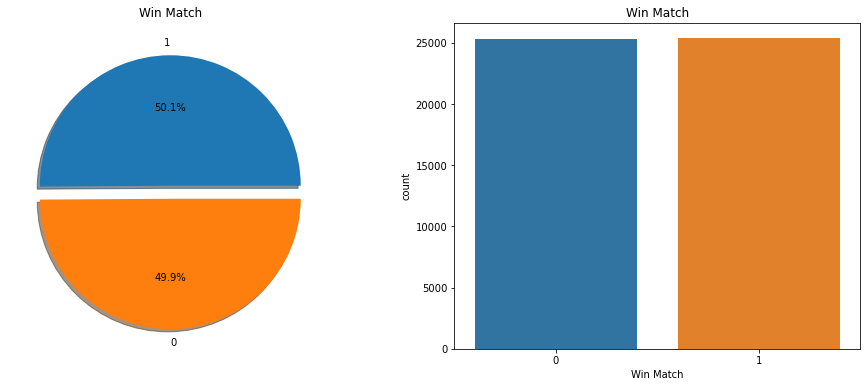

In [786]:
f,ax=plt.subplots(1,2,figsize=(16,6))
new_df_atp['Win Match'].value_counts().plot.pie(explode=[0,0.1],autopct='%1.1f%%',ax=ax[0],shadow=True)
ax[0].set_title('Win Match')
ax[0].set_ylabel('')
sns.countplot('Win Match',data=new_df_atp,ax=ax[1])
ax[1].set_title('Win Match')
plt.show()

As we can see, the class balance is good in the target variable.

## Converting data to numeric values

We will use scikit-learn to train our models. Thus, we will need all our input features to be numeric.

In this part, we will make sure all the columns are numeric using technics such as label encoding or one hot encoding. We will also make sure that the input features and the target classes are balanced.

In [819]:
new_df_atp.dtypes

Location                   object
Tournament                 object
Date               datetime64[ns]
Series                     object
Court                      object
Surface                    object
Round                      object
Best of                     int64
Player 0                   object
Player 1                   object
Player 0 Rank              object
Player 1 Rank              object
Player 0 WinPct           float64
Player 1 WinPct           float64
Win Match                   int64
dtype: object

#### Ranks from str to int

In [820]:
# Lets see the maximum range of the rank values
ranks = []
Ranks0 = new_df_atp["Player 0 Rank"].dropna().unique()
Ranks1 = new_df_atp["Player 1 Rank"].dropna().unique()
ranks = np.concatenate((Ranks0,Ranks1))
ranks = ranks[ranks!="NR"].astype(int)
max_rank = max(ranks) 
max_rank

1890

We want the ranks to have numeric values. 

We will pick the max rank and add 1000 to it to refer to an non ranked player so that it will not be confused with an actual rank(since it is largerly bigger than the highest rank which is 1890).

In [821]:
new_df_atp["Player 0 Rank"] = new_df_atp["Player 0 Rank"].replace("NR",str(max_rank+1000)).astype(int)
new_df_atp["Player 1 Rank"] = new_df_atp["Player 1 Rank"].replace("NR",str(max_rank+1000)).astype(int)

In [822]:
print(new_df_atp["Player 0 Rank"].dtype)
print(new_df_atp["Player 1 Rank"].dtype)

int64
int64


#### Last add on the dataframe before encoding

We will add a column to represent the rank difference between player 1 and player 2.

In [823]:
new_df_atp["Rankdiff"] = (new_df_atp["Player 1 Rank"] - new_df_atp["Player 0 Rank"]).abs()

####  Dataframe copy

In [950]:
encoded_df_atp = new_df_atp.copy()

#### Feature balance

There is a big difference in the number of unique values of our input features. We will try to balance the input features a little bit.

In [951]:
# Lets look at the number of unique values in each column
for col in encoded_df_atp.columns:
    l = 0
    l = encoded_df_atp[col].nunique()
    print(str(col)+" : "+str(l))

Location : 115
Tournament : 212
Date : 4647
Series : 8
Court : 2
Surface : 4
Round : 8
Best of : 2
Player 0 : 976
Player 1 : 1011
Player 0 Rank : 690
Player 1 Rank : 704
Player 0 WinPct : 15255
Player 1 WinPct : 15113
Win Match : 2
Rankdiff : 863


In [952]:
# Round the win percentages
encoded_df_atp["Player 0 WinPct"] = encoded_df_atp["Player 0 WinPct"].round(2)
encoded_df_atp["Player 1 WinPct"] = encoded_df_atp["Player 1 WinPct"].round(2)

# # Bin the winpct columns into intervals
# bins = []
# labels = []
# for i in range(20):
#     bins.append(i*0.05)
#     labels.append((i+1)*5)
# bins.append(1)
    
# encoded_df_atp['Player 0 WinPct'] = pd.cut(
#     encoded_df_atp['Player 0 WinPct'], 
#     bins = bins,
#     labels = labels,
#     include_lowest=True
# )

# encoded_df_atp['Player 1 WinPct'] = pd.cut(
#     encoded_df_atp['Player 1 WinPct'], 
#     bins = bins,
#     labels = labels,
#     include_lowest=True
# )

In [953]:
import math

# Bin the rank columns into intervals    
bins = []
labels = []
nbins = math.ceil(max_rank/10)

for i in range(nbins):
    top = (i+1)*10
    bottom = i*10
    mid = (top+bottom)/2
    bins.append(bottom)
    labels.append(mid)

bins.append(nbins*10)
bins.append(max_rank+1000)

labels.append((2*max_rank+1000)/2)


encoded_df_atp['Player 0 Rank'] = pd.cut(
    encoded_df_atp['Player 0 Rank'], 
    bins = bins,
    labels = labels,
    include_lowest=True
)

encoded_df_atp['Player 1 Rank'] = pd.cut(
    encoded_df_atp['Player 1 Rank'], 
    bins = bins,
    labels = labels,
    include_lowest=True
)

In [954]:
encoded_df_atp["Player 0 Rank"] = encoded_df_atp["Player 0 Rank"].astype(int)
encoded_df_atp["Player 1 Rank"] = encoded_df_atp["Player 1 Rank"].astype(int)
encoded_df_atp["Player 0 WinPct"] = encoded_df_atp["Player 0 WinPct"].astype(float)
encoded_df_atp["Player 1 WinPct"] = encoded_df_atp["Player 1 WinPct"].astype(float)

Finally, we will remove the columns Player 1 and Player 0 since they have too many unique which can bring noise to our model.

In [955]:
encoded_df_atp.drop(columns=["Player 1","Player 0"],inplace=True)

In [956]:
# Lets look at the number of unique values in each column
for col in encoded_df_atp.columns:
    l = 0
    l = encoded_df_atp[col].nunique()
    print(str(col)+" : "+str(l))

Location : 115
Tournament : 212
Date : 4647
Series : 8
Court : 2
Surface : 4
Round : 8
Best of : 2
Player 0 Rank : 120
Player 1 Rank : 123
Player 0 WinPct : 89
Player 1 WinPct : 88
Win Match : 2
Rankdiff : 863


#### Label Encoding

After trying both label and one hot encoding, we decided to proceed with label encoding.

In [957]:
# # One hot encoding Series
# one_hot_series = pd.get_dummies(encoded_df_atp['Series'])
# encoded_df_atp = pd.concat([encoded_df_atp, one_hot_series], axis=1)

# # One hot encoding Court
# one_hot_court = pd.get_dummies(encoded_df_atp['Court'])
# encoded_df_atp = pd.concat([encoded_df_atp, one_hot_court], axis=1)

# # # One hot encoding Surface
# # one_hot_surface = pd.get_dummies(encoded_df_atp['Surface'])
# # encoded_df_atp = pd.concat([encoded_df_atp, one_hot_surface], axis=1)

# # encoded_df_atp.drop(columns=["Court","Surface"],inplace=True)

In [958]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
encoded_df_atp['Tournament'] = le.fit_transform(encoded_df_atp['Tournament'])
encoded_df_atp['Round'] = le.fit_transform(encoded_df_atp['Round'])
encoded_df_atp['Series'] = le.fit_transform(encoded_df_atp['Series'])
encoded_df_atp['Location'] = le.fit_transform(encoded_df_atp['Location'])
encoded_df_atp['Surface'] = le.fit_transform(encoded_df_atp['Surface'])
encoded_df_atp['Court'] = le.fit_transform(encoded_df_atp['Court'])

### Feature selection

We already selected some features from before. But now that all our dataframe columns are numeric, we will plot the correlation matrix to see which features have no correlation or strong correlation with our output variable.

/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/3078627949.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = encoded_df_atp.corr()
/var/folders/gl/65b8zpcs3_50ssdz8qstbr240000gn/T/ipykernel_62494/3078627949.py:5: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.zeros_like(corr, dtype=np.bool)


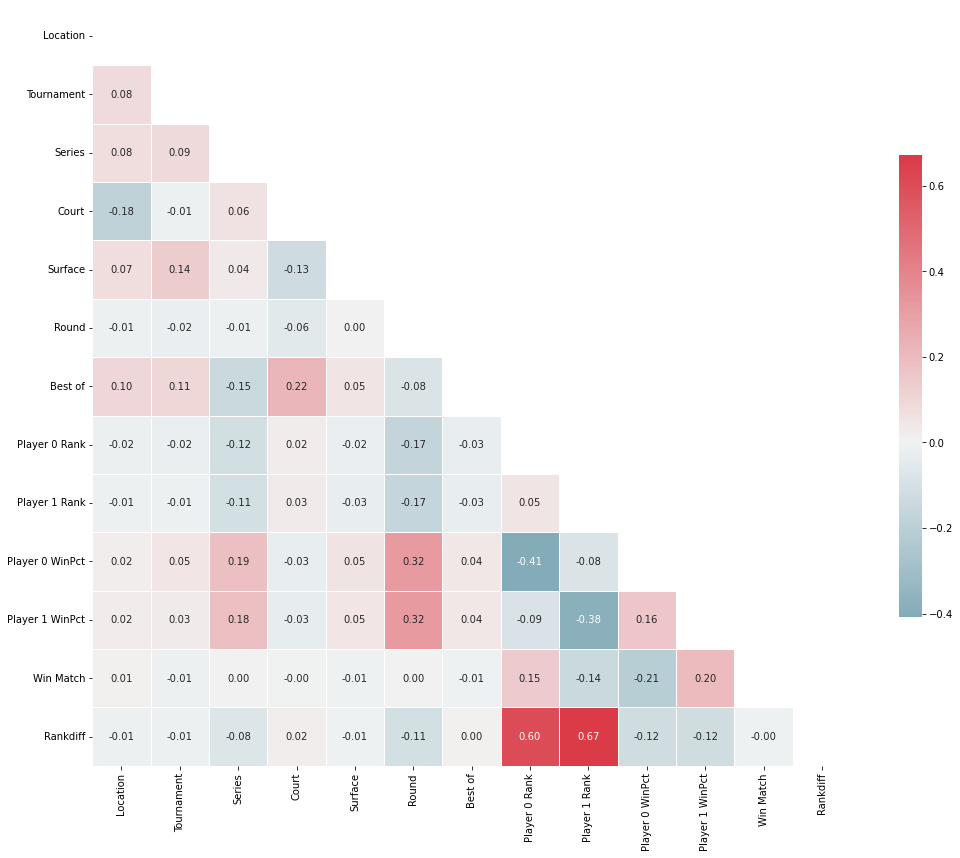

In [959]:
# Compute the correlation matrix
corr = encoded_df_atp.corr()

# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
fig, ax = plt.subplots(figsize=(17,17))

# Define the colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f')

# Show the plot
plt.show()

We can see that some features have no correlation with "Win Match". Let's remove them.

In [960]:
encoded_df_atp.drop(columns=["Rankdiff","Series","Court","Round"],inplace=True)

## Modeling

### Train/Test split

We will split our dataset to 2 sets : training set and test set.

The test set will be composed of matches that occured during 2017. The train set will be composed of the rest of the dataset.

In [1020]:
mod_df = encoded_df_atp.copy()

In [1021]:
from sklearn.utils import shuffle

# Sort the dataframe by the Date column in ascending order
mod_df.sort_values('Date', inplace=True)

# Split the dataset into training and testing sets based on a certain date or percentage of the data
split_date = '2017-01-01'
train_df = mod_df[mod_df['Date'] < split_date]
test_df = mod_df[mod_df['Date'] >= split_date]

# Shuffle the training and testing sets separately
train_df = shuffle(train_df)
test_df = shuffle(test_df)

# Removing the date column
train_df.drop(columns=["Date"],inplace=True)
test_df.drop(columns=["Date"],inplace=True)

# Combine the shuffled training and testing sets into two new dataframes
train_df.reset_index(inplace=True, drop=True)
test_df.reset_index(inplace=True, drop=True)

In [1022]:
print(train_df.shape)
print(test_df.shape)

(45504, 9)
(5172, 9)


In [1023]:
X_train = train_df.drop('Win Match',axis=1)
y_train = train_df['Win Match']

X_test = test_df.drop('Win Match',axis=1)
y_test = test_df['Win Match']

### Decision Tree

In [1024]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, f1_score
from sklearn.metrics import plot_confusion_matrix

# Create decision tree classifier instance
dt_classifier = DecisionTreeClassifier(random_state=42)

# Train the model on the training data
dt_classifier.fit(X_train, y_train)

# Predict labels of test data
y_pred_dt = dt_classifier.predict(X_test)

# Evaluate performance of decision tree
accuracy_dt = accuracy_score(y_test, y_pred_dt)
f1_dt = f1_score(y_test, y_pred_dt)

print("Accuracy:", accuracy_dt)
print("F1 score:", f1_dt)

Accuracy: 0.568445475638051
F1 score: 0.5709342560553633


/Users/yahya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


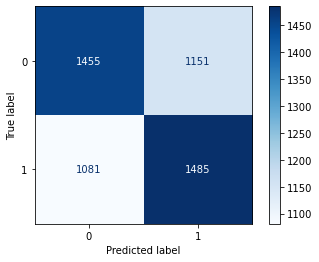

In [1025]:
# Plot confusion matrix
plot_confusion_matrix(dt_classifier, X_test, y_test, cmap=plt.cm.Blues)
plt.show()

### Logistic Regression

In [1026]:
from sklearn.linear_model import LogisticRegression

# Create logistic regression classifier instance
logmodel = LogisticRegression(random_state=42,max_iter=700)

# Train the model on the training data
logmodel.fit(X_train,y_train)

# Predict labels of test data
y_pred_log = logmodel.predict(X_test)

# Evaluate performance of decision tree
accuracy_log = accuracy_score(y_test, y_pred_log)
f1_log = f1_score(y_test, y_pred_log)

print("Accuracy:", accuracy_log)
print("F1 score:", f1_log)

Accuracy: 0.6345707656612529
F1 score: 0.6377922575699502


/Users/yahya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


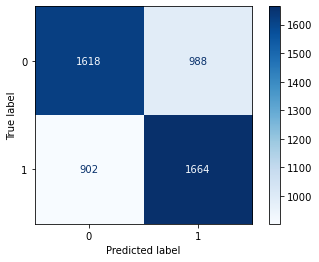

In [1027]:
# Plot confusion matrix
plot_confusion_matrix(logmodel, X_test, y_test, cmap=plt.cm.Blues)
plt.show()

### Random Forest

To find the best hyperparameters, we will use GridSearchCV.

In [1028]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report

# define the parameter grid to search
param_grid = {
    'n_estimators': [200,400,600],
    'max_depth': [3, 5, 10],
    'min_samples_split': [2, 5, 10]
}

# instantiate the RandomForestClassifier and GridSearchCV objects
rfc = RandomForestClassifier()
grid_search = GridSearchCV(rfc, param_grid, cv=5, n_jobs=-1)

# fit the GridSearchCV object to the data
grid_search.fit(X_train, y_train)

# get the best model
best_rfc = grid_search.best_estimator_

# evaluate the best model
y_pred = best_rfc.predict(X_test)

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.65      0.63      0.64      2606
           1       0.63      0.65      0.64      2566

    accuracy                           0.64      5172
   macro avg       0.64      0.64      0.64      5172
weighted avg       0.64      0.64      0.64      5172



In [1029]:
# Print the best parameters and corresponding accuracy score
print("Best parameters: ", grid_search.best_params_)
print("Best accuracy score: ", grid_search.best_score_)

Best parameters:  {'max_depth': 10, 'min_samples_split': 2, 'n_estimators': 600}
Best accuracy score:  0.6616560213767114


Let's use feature importance to verify if our feature selection was correct and to see if there is any other changes to make.

In [1030]:
# Get the feature importances and corresponding feature names
importances = best_rfc.feature_importances_
feature_names = X_train.columns

# Create a DataFrame with the feature importances and feature names
feature_importances = pd.DataFrame({"Feature": feature_names, "Importance": importances})

# Sort the DataFrame by importance (highest to lowest)
feature_importances = feature_importances.sort_values(by="Importance", ascending=False)

# Print the feature importances
print(feature_importances)

           Feature  Importance
4    Player 0 Rank    0.232997
5    Player 1 Rank    0.231265
6  Player 0 WinPct    0.207405
7  Player 1 WinPct    0.202171
1       Tournament    0.051190
0         Location    0.048355
2          Surface    0.015694
3          Best of    0.010921


Based on this, we can see that the most relevent features are Player Ranks and Win Percentages. Tournament, location, surface and best of are much less relevent. 

N.B : we removed the less relevent features and tested our model, but the results were almost the same, so we kept them anyways.

In [1031]:
from xgboost import XGBClassifier

# Define XGBoost classifier
xgb = XGBClassifier()

# Define hyperparameters to tune
param_grid = {
    'max_depth': [3, 4, 5],
    'learning_rate': [0.1, 0.01],
    'n_estimators': [100, 500, 1000]
}

# Define GridSearchCV with 5-fold cross validation
grid_search = GridSearchCV(estimator=xgb, param_grid=param_grid, cv=5, n_jobs=-1)

# Fit the grid search to the training data
grid_search.fit(X_train, y_train)

# Print the best parameters and best score
print("Best parameters: ", grid_search.best_params_)
print("Best score: ", grid_search.best_score_)

Best parameters:  {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500}
Best score:  0.6614142993584813


/Users/yahya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


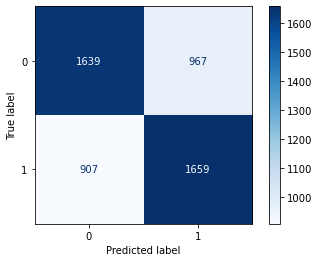

In [1032]:
# get the best model
best_xgb = grid_search.best_estimator_

# Plot confusion matrix
plot_confusion_matrix(best_xgb, X_test, y_test, cmap=plt.cm.Blues)
plt.show()

The best score we could reach was 0.66 on xgboost and random forest. This score indicates that our tennis match prediction model is capable of correctly predicting the outcomes in approximately 66% of the cases. This can be considered a relatively good score, but depending on the model's goal and application domain, this result may be considered insufficient. For example, if the model is used for sports betting, a score of 66% may not be sufficient to be profitable.